In [1]:
%%bash
pip3 install torch torchvision
pip3 install pillow==4.1.1
git clone https://github.com/sergeisoly/CycleGAN

fatal: destination path 'CycleGAN' already exists and is not an empty directory.


In [0]:
%matplotlib inline
from PIL import Image
import itertools

import torch
import torch.nn as nn
from torch.utils.data import Dataset
from torch.utils.data import DataLoader
import torch.nn.functional as F
import torch.optim as optim

import matplotlib.pyplot as plt

import glob
import random
import os

import torchvision.transforms as transforms
import torchvision.models as models

import copy
import warnings
from tqdm import tqdm, tqdm_notebook
from IPython.display import clear_output

import warnings
warnings.simplefilter(action='ignore')

from CycleGAN import nets, functions, data

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)
!nvidia-smi

cuda
Mon Jun 15 20:13:43 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 450.36.06    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   36C    P0    26W / 250W |     10MiB / 16280MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+--

In [0]:
%%bash
unzip /content/drive/My\ Drive/DLSchool/CycleGAN/arcDataset.zip -d data
cp -r data/arcDataset/Gothic\ architecture data/trainB
cp -r data/arcDataset/International\ style data/trainA
mkdir data/testA
mkdir data/testB

In [0]:
DATA_PATH = "data/"
NUM_WORKERS = 4
IMAGE_SIZE = 256

In [0]:
# This functions creates test set
# and remove grayscale images
data.prepare_dataset(DATA_PATH)

In [0]:
test_transforms = [transforms.Resize((600, 800)),
                   transforms.ToTensor(),
                transforms.Normalize((0.5,0.5,0.5), (0.5,0.5,0.5)) ]
test_loader = DataLoader(data.ImageDataset(DATA_PATH, transforms_=test_transforms, mode='test', unaligned=False), 
                        batch_size=1, shuffle=False, num_workers=NUM_WORKERS)

In [8]:
%%bash
gdown -O gen_backward.pth https://drive.google.com/uc?id=1-BWu2t9xUkpBxr3Z1AZ_sPZZtoL6yC2R
gdown -O gen_forward.pth https://drive.google.com/uc?id=1-60KbtAGuehHqVxuYyetXTr5TA3J1Nnz

Downloading...
From: https://drive.google.com/uc?id=1-BWu2t9xUkpBxr3Z1AZ_sPZZtoL6yC2R
To: /content/gen_backward.pth
45.5MB [00:00, 46.8MB/s]
Downloading...
From: https://drive.google.com/uc?id=1-60KbtAGuehHqVxuYyetXTr5TA3J1Nnz
To: /content/gen_forward.pth
45.5MB [00:00, 80.6MB/s]


In [0]:
gen_forward = nets.Generator().to(device)
gen_backward = nets.Generator().to(device)

gen_forward.load_state_dict(torch.load('gen_forward.pth', map_location=torch.device(device)))
gen_forward.eval()

gen_backward.load_state_dict(torch.load('gen_backward.pth', map_location=torch.device(device)))
gen_backward.eval();

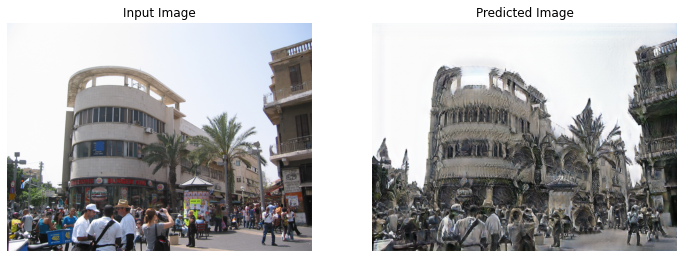

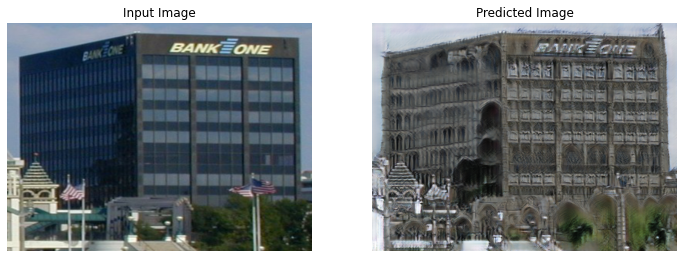

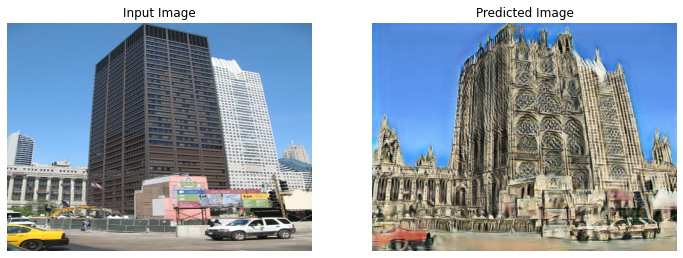

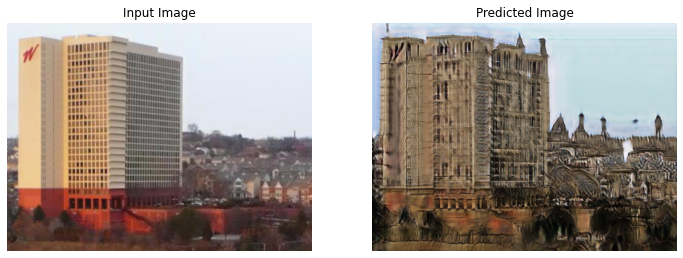

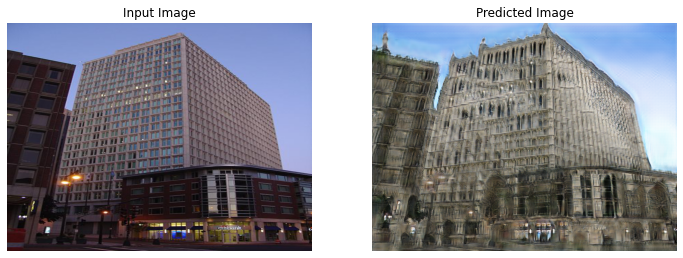

...

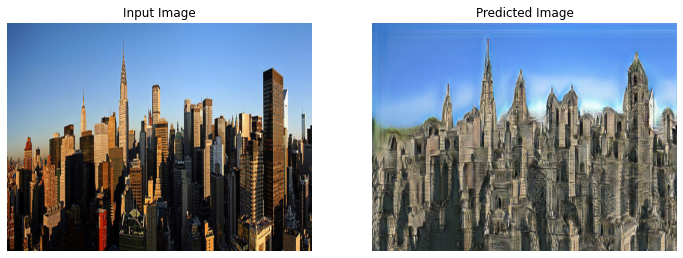

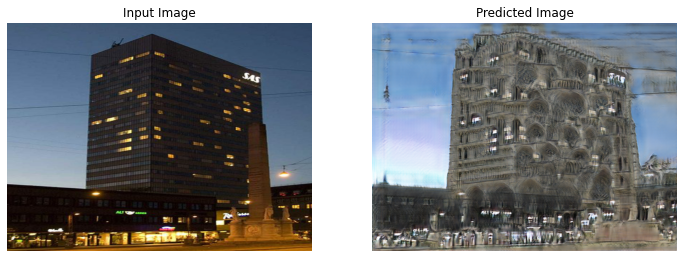

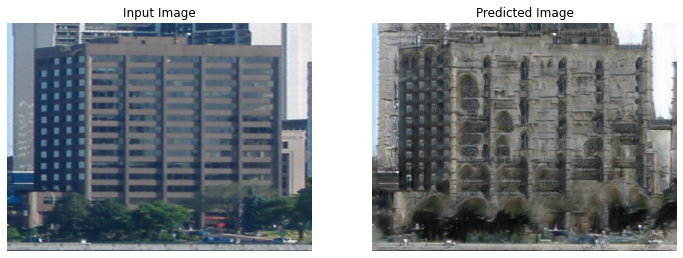

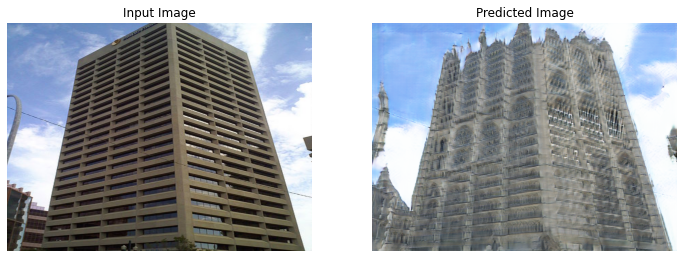

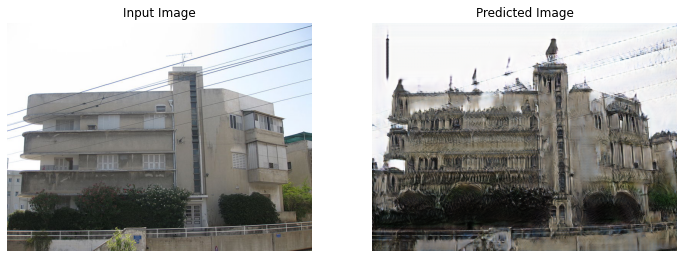

In [17]:
pics = []
for sample in test_loader:
    pics.append((sample['A'], sample['B']))

for pic in pics:
    functions.generate_images(gen_forward, pic[0], device)

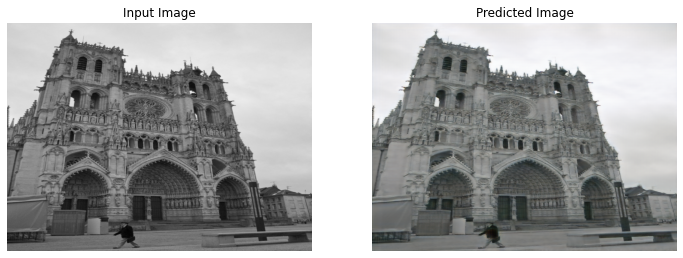

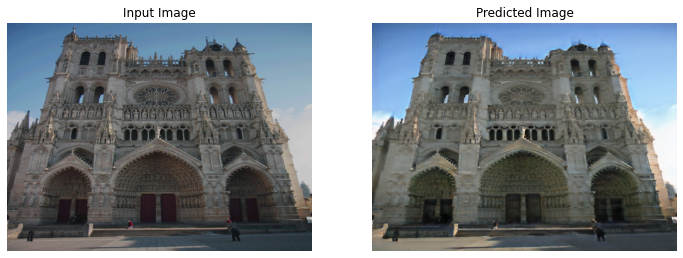

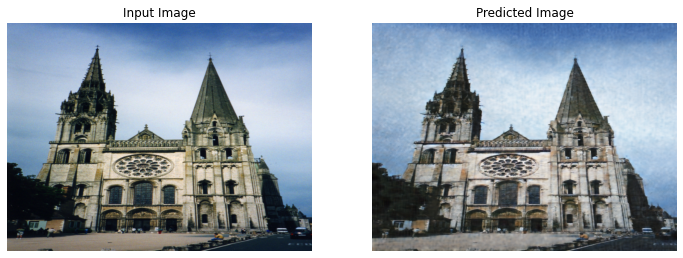

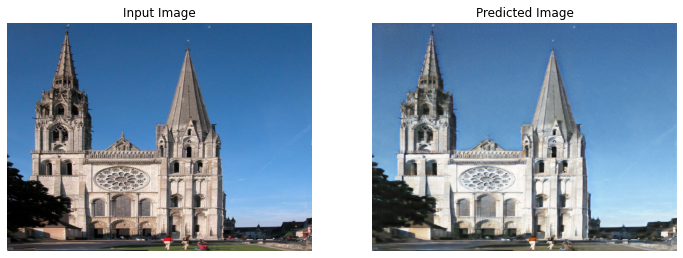

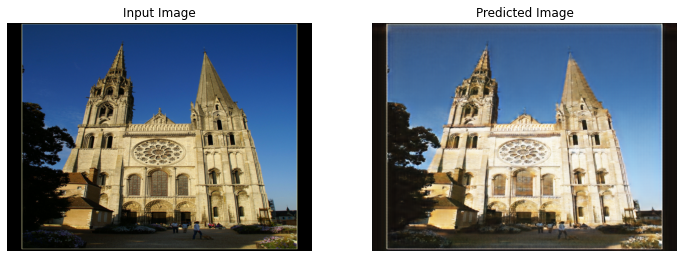

...

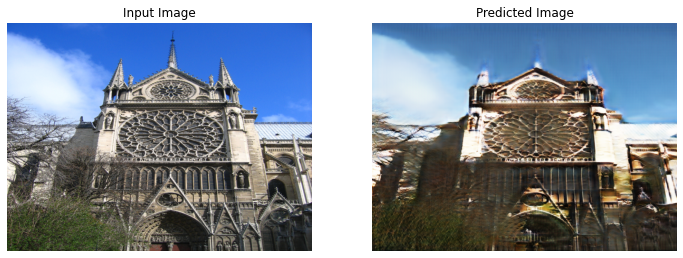

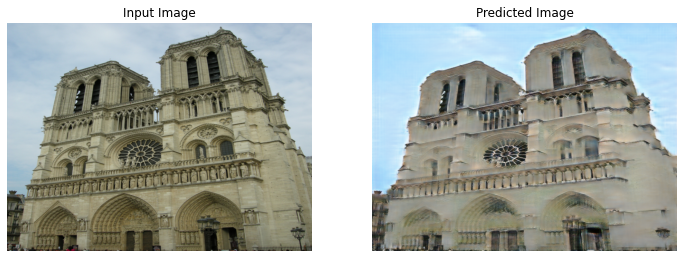

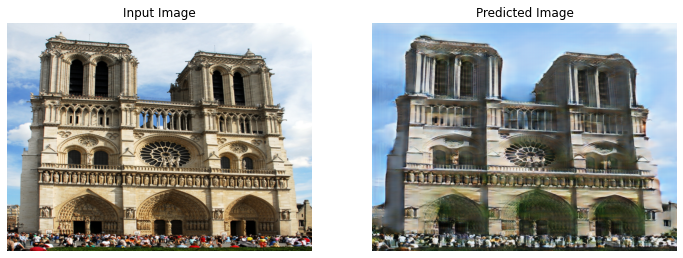

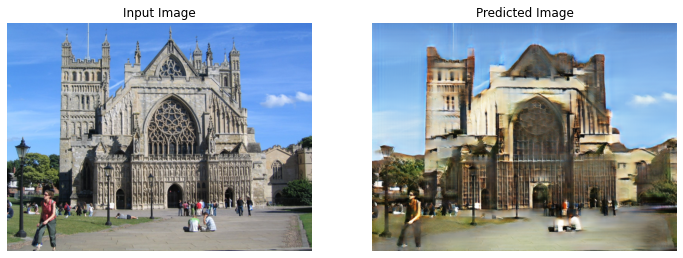

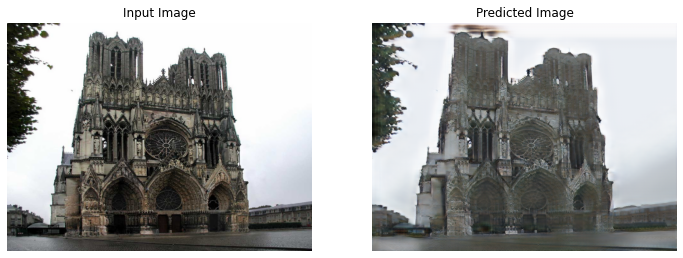

In [18]:
for pic in pics:
    functions.generate_images(gen_backward, pic[1], device)

In [0]:
def save_result(model, test_input, path, fname, device='cuda'):
    test_input = test_input.to(device)
    prediction = model(test_input)
    
    plt.figure(figsize=(12, 12))
    test_input = test_input.detach().cpu().squeeze(0).permute(1, 2, 0)
    prediction = prediction[0].detach().cpu().permute(1, 2, 0)
    display_list = [test_input, prediction]
    title = ['Input Image', 'Predicted Image']

    for i in range(2):
        plt.subplot(1, 2, i+1)
        plt.title(title[i])
        plt.imshow(display_list[i] * 0.5 + 0.5)
        plt.axis('off')
    plt.savefig(f"{path}/{fname}.jpg", bbox_inches='tight')

In [0]:
train_loader = DataLoader(data.ImageDataset(DATA_PATH, transforms_=test_transforms, mode='train', unaligned=False), 
                        batch_size=1, shuffle=False, num_workers=NUM_WORKERS)

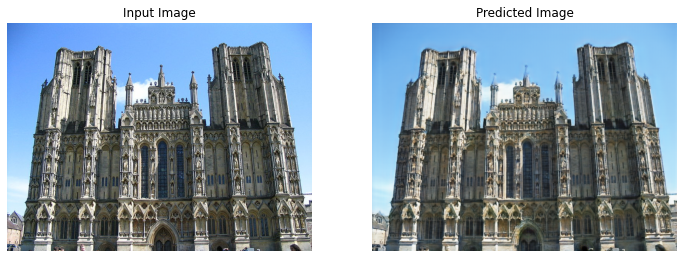

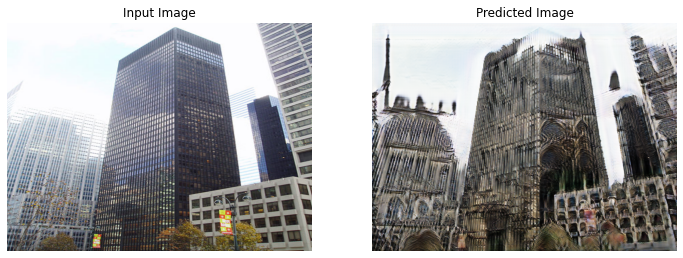

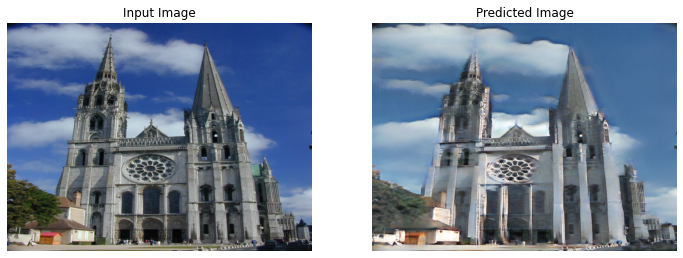

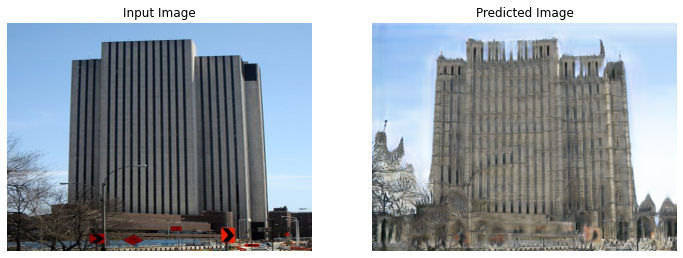

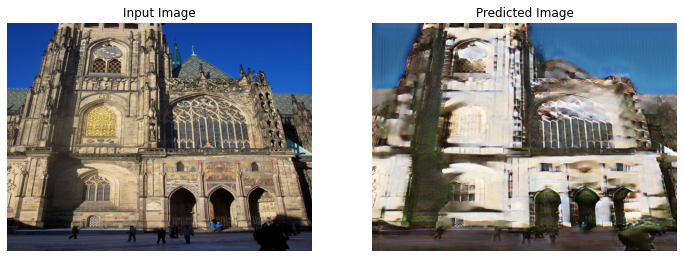

...

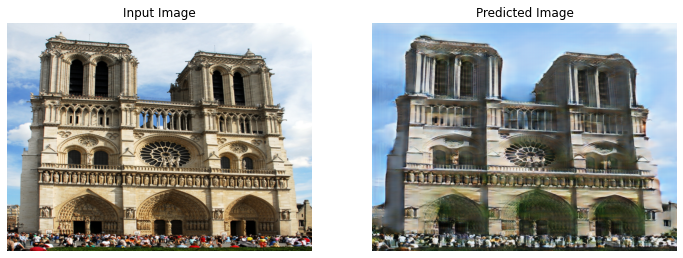

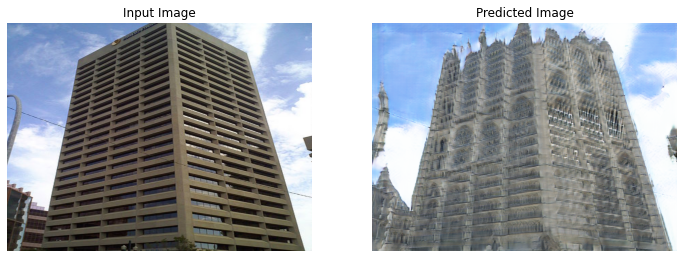

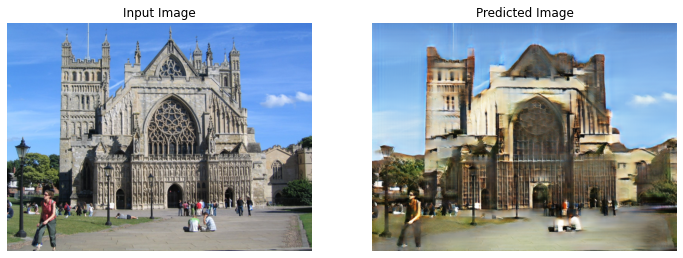

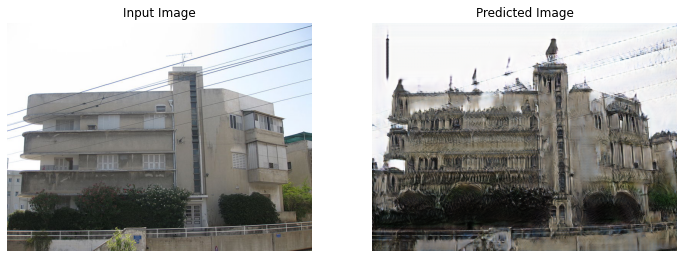

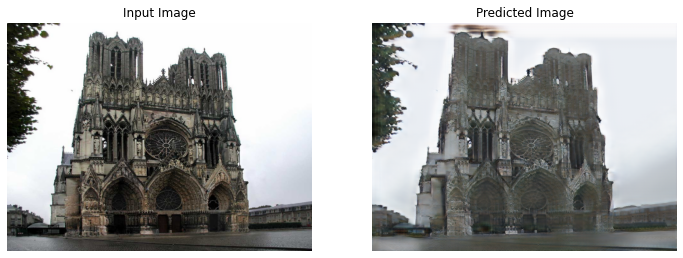

In [21]:
path = '/content/drive/My Drive/DLSchool/CycleGAN/images'
for i, sample in enumerate(test_loader):
    save_result(gen_forward, sample['A'], path, f"X2Y_{i}")
    save_result(gen_backward, sample['B'], path, f"Y2X_{i}")